In [220]:
from pathlib import Path
from glob import glob

# Standard library
import os
import hashlib

# Third-party libraries
import cv2
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
import imagehash
import shutil
from sklearn.neighbors import NearestNeighbors

In [221]:
outdir = Path("results")
if outdir.exists():
    shutil.rmtree(outdir)
    
outdir.mkdir(parents=True, exist_ok=True)

## Load images from folder


In [222]:
CLASS_NAMES = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

def load_images_from_folder(folder):
    images = []
    labels = []
    categories = []        
    image_paths = []       

    for label, className in enumerate(CLASS_NAMES):
        class_folder = os.path.join(folder, className)
        for filename in os.listdir(class_folder):
            img_path = os.path.join(class_folder, filename)
            img = cv2.imread(img_path)

            if img is None:
                continue

            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (128, 128))

            rel_path = "/" + os.path.join(className, filename)
            images.append(img)
            labels.append(label)
            categories.append(className)
            image_paths.append(rel_path)

    return (
        np.array(images, dtype=np.uint8),
        np.array(labels, dtype=np.int64),
        np.array(categories, dtype=object),
        np.array(image_paths, dtype=object)
    )

In [223]:
X_train, y_train, train_categories, train_paths = load_images_from_folder('intel-image-classification/seg_train/seg_train/')
X_test, y_test, categories_test, test_paths = load_images_from_folder('intel-image-classification/seg_test/seg_test/')

In [224]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(14034, 128, 128, 3) (14034,)
(3000, 128, 128, 3) (3000,)


In [225]:
train_counts = pd.Series(y_train).value_counts().sort_index()
test_counts = pd.Series(y_test).value_counts().sort_index()
for i, class_name in enumerate(CLASS_NAMES):
    print(f"Class '{class_name}': {train_counts[i]} train images, {test_counts[i]} test images")

Class 'buildings': 2191 train images, 437 test images
Class 'forest': 2271 train images, 474 test images
Class 'glacier': 2404 train images, 553 test images
Class 'mountain': 2512 train images, 525 test images
Class 'sea': 2274 train images, 510 test images
Class 'street': 2382 train images, 501 test images


In [226]:
def display_sample_images_per_class(
        X, y, class_names,
        samples_per_class=5,
        fig_title="Sample Images per Class",
        save_prefix=None,
        outdir="results"
    ):
    num_classes = len(class_names)
    fig, axes = plt.subplots(
        num_classes,
        samples_per_class,
        figsize=(samples_per_class * 2, num_classes * 2)
    )

    if num_classes == 1:
        axes = np.expand_dims(axes, axis=0)
    if samples_per_class == 1:
        axes = np.expand_dims(axes, axis=1)

    for class_idx, class_name in enumerate(class_names):
        class_images = X[y == class_idx]
        selected_indices = np.random.choice(
            len(class_images), samples_per_class, replace=False
        )

        for sample_idx, img_idx in enumerate(selected_indices):
            ax = axes[class_idx, sample_idx]
            ax.imshow(class_images[img_idx])
            ax.axis('off')

        mid_col = samples_per_class // 2
        axes[class_idx, mid_col].set_title(class_name, fontsize=12)
    fig.suptitle(fig_title, y=0.99)
    fig.tight_layout(rect=[0, 0, 1, 0.97])

    if save_prefix:
        folder = Path(outdir) / save_prefix
        folder.mkdir(parents=True, exist_ok=True)
        fig.savefig(folder / f"{save_prefix}_sample_images_per_class.png")

    # plt.show()
    plt.close(fig)

    
display_sample_images_per_class(X_train, y_train, CLASS_NAMES, samples_per_class=5, fig_title="Sample Images per Class in Training Set", save_prefix="train", outdir=outdir)
display_sample_images_per_class(X_test, y_test, CLASS_NAMES, samples_per_class=5, fig_title="Sample Images per Class in Test Set", save_prefix="test", outdir=outdir)

## Detect Miscategorized Images

In [227]:
def extract_hsv_hist_features(images, h_bins=8, s_bins=8, v_bins=8):
    """
    images: np.array of shape (N, 128, 128, 3) in RGB, uint8 (from your loader)
    returns: np.array of shape (N, h_bins * s_bins * v_bins) of float32
    """
    features = []

    for img in images:
        hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)

        # 3D histogram over H, S, V
        hist = cv2.calcHist(
            [hsv],
            channels=[0, 1, 2],
            mask=None,
            histSize=[h_bins, s_bins, v_bins],
            ranges=[0, 180, 0, 256, 0, 256]
        )

        # Normalize histogram and flatten
        hist = cv2.normalize(hist, hist).flatten()
        features.append(hist)

    return np.array(features, dtype=np.float32)


In [228]:
train_features = extract_hsv_hist_features(X_train)

In [229]:
def find_suspicious_by_knn(
    features,
    labels,
    paths,
    k=20,
    neighbor_diff_threshold=0.8,
    min_alt_frac=0.6,
    max_per_class=None,
):
    """
    features: np.array (N, D) feature vectors
    labels:   np.array (N,) int labels (0..C-1)
    paths:    np.array (N,) strings like "/forest/2121.png"
    k:        number of neighbors (excluding self)
    neighbor_diff_threshold:
        fraction of neighbors with a different label than the sample
        (e.g. 0.8 means: at least 80% of neighbors disagree with its label)
    min_alt_frac:
        among neighbors with a *different* label, the majority alternative label
        must cover at least this fraction of ALL neighbors.
        (forces neighbors to mostly agree on *one* other class)
    max_per_class:
        if not None, keep at most this many most suspicious samples per class.

    returns:
        suspicious_indices: np.array of indices into features/labels/paths
        disagreement_scores: np.array of floats in [0,1] (frac of neighbors that disagree)
    """
    n_neighbors = k + 1  # +1 because first neighbor will be the sample itself

    nn = NearestNeighbors(n_neighbors=n_neighbors, metric='euclidean')
    nn.fit(features)

    distances, indices = nn.kneighbors(features)

    # Collect candidates per true class (for optional max_per_class)
    classes = np.unique(labels)
    per_class_candidates = {c: [] for c in classes}

    for i in range(features.shape[0]):
        neigh_idx = indices[i, 1:]          # exclude self
        neigh_labels = labels[neigh_idx]

        # fraction of neighbors with a different label
        frac_diff = np.mean(neigh_labels != labels[i])
        if frac_diff < neighbor_diff_threshold:
            continue

        # now check if neighbors mostly agree on a single alternative class
        alt_labels = neigh_labels[neigh_labels != labels[i]]
        if alt_labels.size == 0:
            continue

        values, counts = np.unique(alt_labels, return_counts=True)
        alt_majority_frac = counts.max() / k

        if alt_majority_frac < min_alt_frac:
            # neighbors disagree with the label but are not consistent about *which* other class it is
            continue

        # candidate accepted
        true_class = labels[i]
        per_class_candidates[true_class].append((i, frac_diff, alt_majority_frac))

    # Flatten candidates, possibly limiting per class
    selected_indices = []
    selected_scores = []

    for c, cand_list in per_class_candidates.items():
        if not cand_list:
            continue

        # sort by disagreement score (frac_diff) descending
        cand_list_sorted = sorted(cand_list, key=lambda t: t[1], reverse=True)

        if max_per_class is not None:
            cand_list_sorted = cand_list_sorted[:max_per_class]

        for idx, frac_diff, alt_frac in cand_list_sorted:
            selected_indices.append(idx)
            selected_scores.append(frac_diff)

    if len(selected_indices) == 0:
        return np.array([], dtype=int), np.array([], dtype=float)

    selected_indices = np.array(selected_indices, dtype=int)
    selected_scores = np.array(selected_scores, dtype=float)

    return selected_indices, selected_scores

In [230]:
sus_train_idx, train_scores = find_suspicious_by_knn(
    train_features,
    y_train,
    train_paths,
    k=20,                           # more neighbors → more stable
    neighbor_diff_threshold=0.85,   # require stronger disagreement
    min_alt_frac=0.7,               # neighbors must mostly agree on *one* alt class
    max_per_class=150               # optional cap: at most 150 per true class
)

# Suspicious labels and counts
sus_train_labels = y_train[sus_train_idx]
sus_counts = pd.Series(sus_train_labels).value_counts().sort_index()

# Total images per class
class_counts = pd.Series(y_train).value_counts().sort_index()

rows = []
for class_idx, class_name in enumerate(CLASS_NAMES):
    total_n = int(class_counts.get(class_idx, 0))
    susp_n = int(sus_counts.get(class_idx, 0))
    share_susp = (susp_n / total_n * 100) if total_n > 0 else 0.0

    rows.append([
        class_name,
        total_n,
        susp_n,
        share_susp,
    ])

sus_metrics_df = pd.DataFrame(
    rows,
    columns=[
        "Class",
        "Total images",
        "Suspicious images",
        "Share suspicious",
    ],
)

display(
    sus_metrics_df.style
        .format({
            "Total images": "{:,.0f}",
            "Suspicious images": "{:,.0f}",
            "Share suspicious": "{:.2f}%",
        })
        .hide(axis="index")
)

Class,Total images,Suspicious images,Share suspicious
buildings,"2,191",103,4.70%
forest,"2,271",15,0.66%
glacier,"2,404",48,2.00%
mountain,"2,512",149,5.93%
sea,"2,274",112,4.93%
street,"2,382",60,2.52%


In [231]:
def plot_suspicious_images(
    X,
    y,                  
    paths,
    suspicious_indices,
    scores=None,
    max_images_per_class=40,
    cols=5,
    save_dir=None,
):
    """
    Plots suspicious images grouped by label (class).
    """

    if len(suspicious_indices) == 0:
        print("No suspicious images found with current settings.")
        return

    suspicious_indices = np.array(suspicious_indices)
    y = np.asarray(y)

    if scores is not None:
        scores = np.asarray(scores)
        if len(scores) != len(suspicious_indices):
            raise ValueError("scores must have same length as suspicious_indices")

    # TEMP FIX: force correct label->name mapping based on y_train encoding
    label_to_name = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

    if save_dir is not None:
        os.makedirs(save_dir, exist_ok=True)

    # Only consider labels actually present among suspicious indices
    susp_labels = y[suspicious_indices]
    unique_labels = np.unique(susp_labels)

    for label_id in unique_labels:
        class_name = label_to_name[label_id]

        mask = (susp_labels == label_id)
        class_susp_indices = suspicious_indices[mask]
        class_scores = scores[mask] if scores is not None else None

        # Sort by score descending if provided
        if class_scores is not None:
            order = np.argsort(-class_scores)
            class_susp_indices = class_susp_indices[order]

        # Limit per class
        class_susp_indices_ = class_susp_indices[:max_images_per_class]
        n = len(class_susp_indices_)
        rows = math.ceil(n / cols)
        print(f"{class_name}: {n} suspicious images")

        # Bigger images: scale with rows/cols
        fig_width = 3 * cols
        fig_height = 3 * rows
        fig, axes = plt.subplots(rows, cols, figsize=(fig_width, fig_height))
        axes = np.array(axes).reshape(-1)

        for ax_i, idx in enumerate(class_susp_indices_):
            ax = axes[ax_i]
            img = X[idx]
            if img.dtype != np.uint8:
                img = (np.clip(img, 0, 1) * 255).astype(np.uint8)

            ax.imshow(img)
            ax.axis("off")

            path_str = str(paths[idx])
            if path_str.startswith("/"):
                path_str = path_str[1:]
            ax.set_title(path_str, fontsize=7, pad=6)

        for ax in axes[n:]:
            ax.axis("off")

        # Correct title + less space between title and images
        fig.suptitle(
            f"Suspicious images detected in '{class_name}' category",
            fontsize=14,
            y=0.98,
        )
        # Let subplots move up (less vertical gap under title)
        fig.tight_layout(rect=[0, 0, 1, 0.96])
        fig.subplots_adjust(wspace=0.02)

        if save_dir is not None:
            fname = os.path.join(save_dir, f"{class_name}_suspicious.png")
            fig.savefig(fname, dpi=150, bbox_inches="tight")

         
        # plt.show()


buildings: 40 suspicious images
forest: 15 suspicious images
forest: 15 suspicious images
glacier: 40 suspicious images
glacier: 40 suspicious images
mountain: 40 suspicious images
mountain: 40 suspicious images
sea: 40 suspicious images
sea: 40 suspicious images
street: 40 suspicious images
street: 40 suspicious images


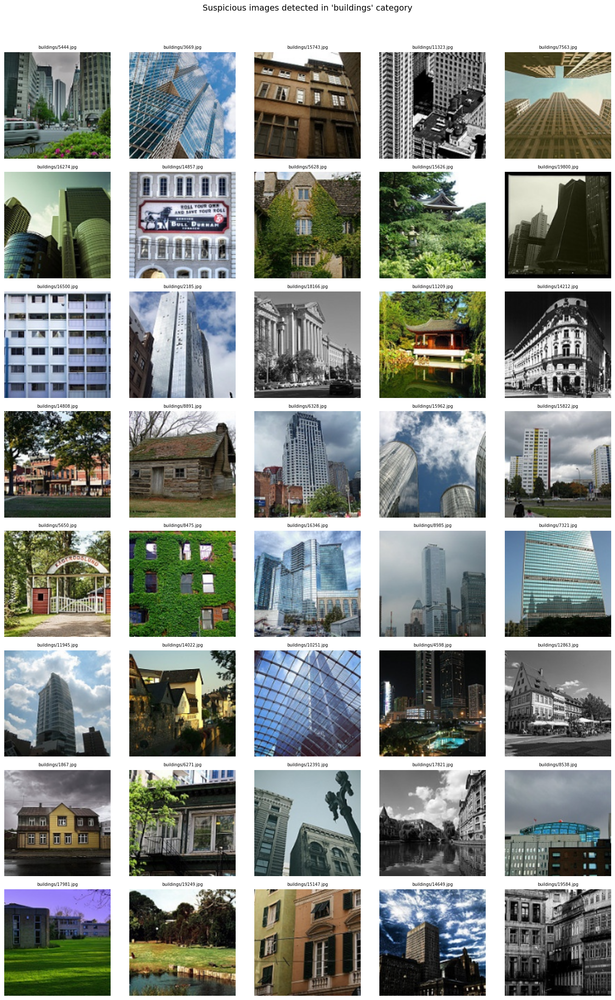

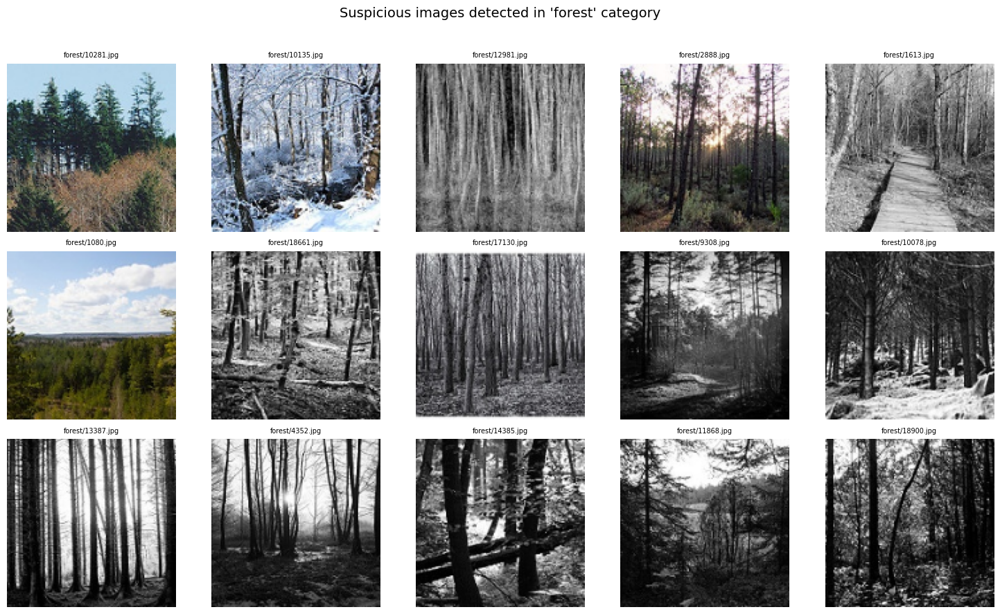

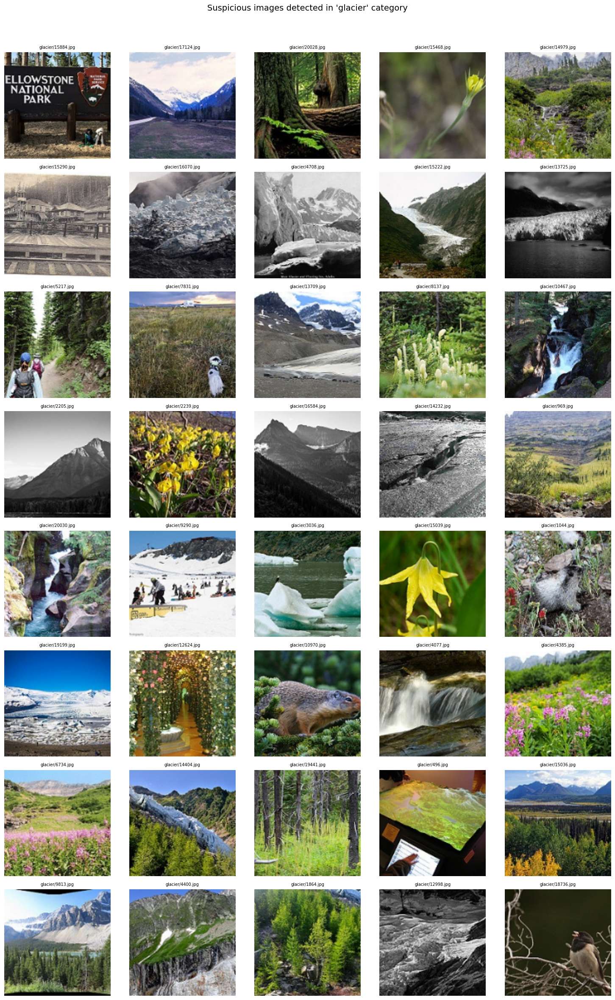

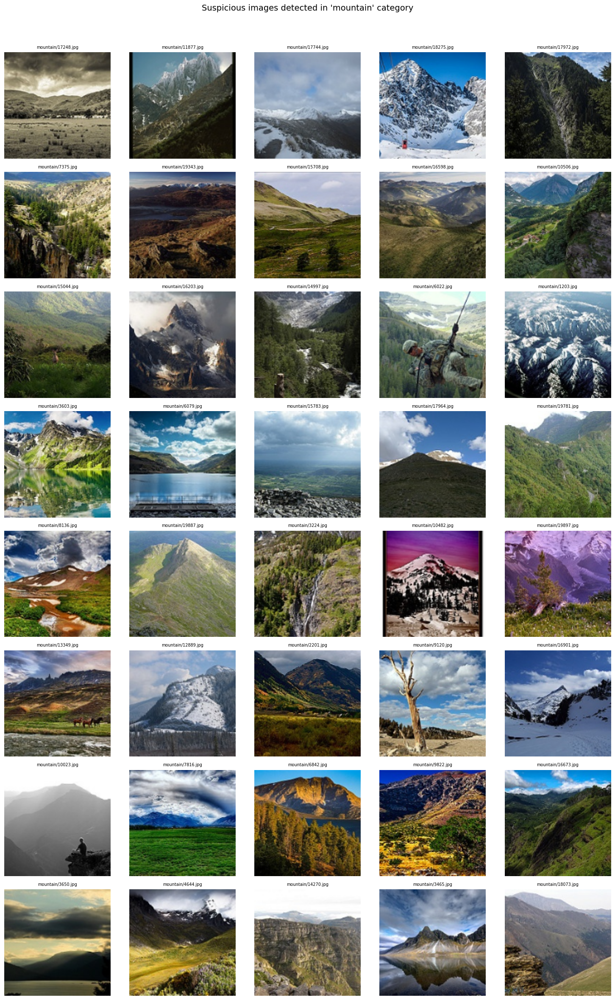

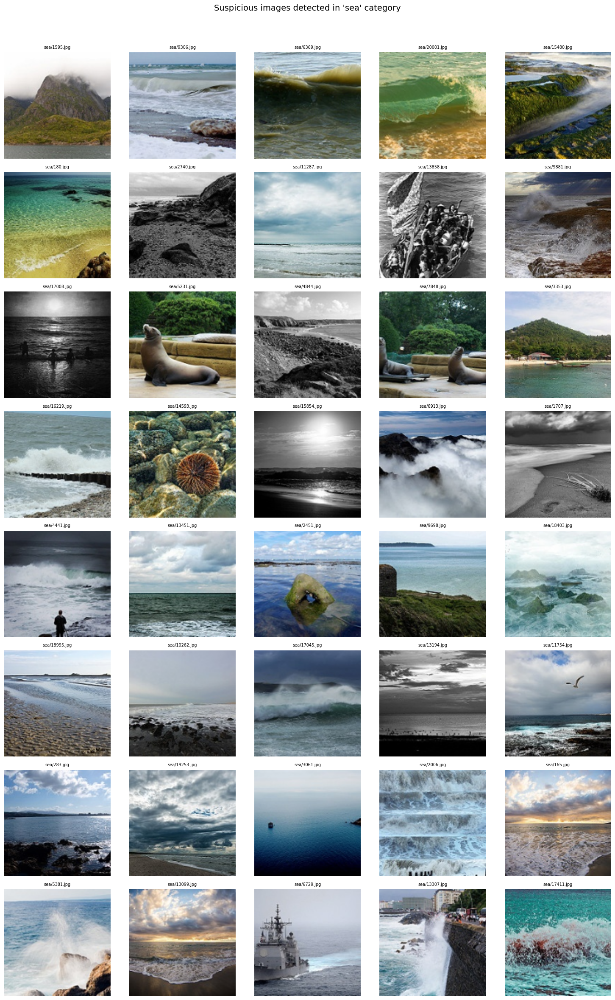

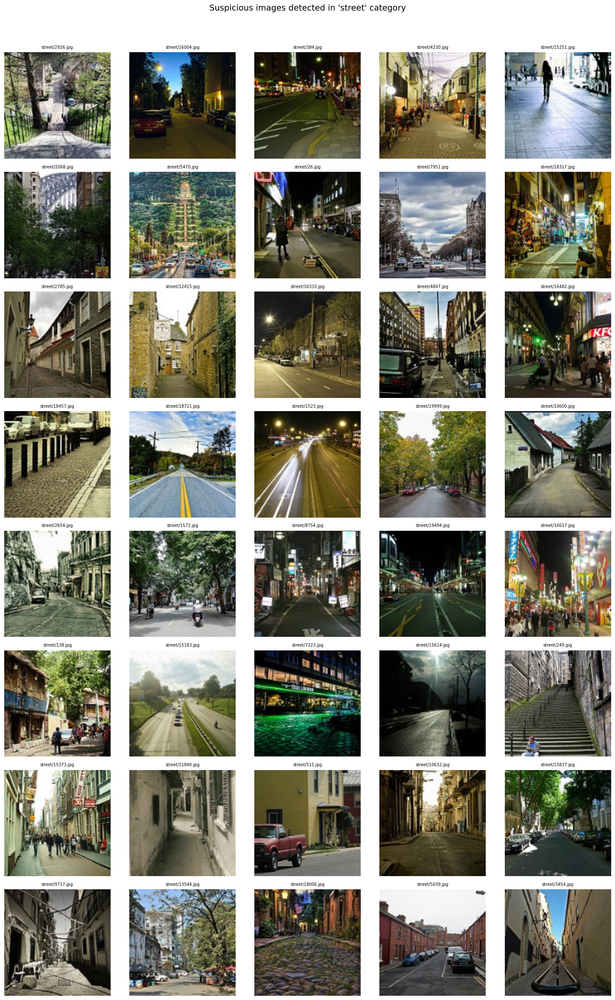

In [232]:
plot_suspicious_images(
    X_train,
    y_train,
    train_paths,
    suspicious_indices=sus_train_idx,
    scores=train_scores,
    save_dir="results/knn_suspicious",
)

In [233]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt

target_rel = "glacier/15039.jpg"

# ensure we operate on a string array for np.char functions
train_paths_str = np.asarray(train_paths, dtype=str)
matches = np.where(np.char.endswith(train_paths_str, target_rel))[0]
if len(matches) == 0:
    raise ValueError(f"No training image path ends with {target_rel}")
target_idx = matches[0]

print("Target index:", target_idx)
print("Target path:", train_paths_str[target_idx])
print("Target label (y_train):", y_train[target_idx], "->", CLASS_NAMES[y_train[target_idx]])

# Fit NN on train_features if not already done
nn = NearestNeighbors(n_neighbors=21, metric="euclidean")  # 1 (self) + 20 neighbors
nn.fit(train_features)

distances, indices = nn.kneighbors(train_features[target_idx:target_idx+1])
neighbor_indices = indices[0, 1:]  
neighbor_distances = distances[0, 1:]
neighbor_labels = y_train[neighbor_indices]

print("\nTop-10 neighbors (idx, class, distance):")
for idx, lab, dist in list(zip(neighbor_indices, neighbor_labels, neighbor_distances))[:10]:
    print(f"  idx={idx:5d}, class={CLASS_NAMES[lab]:9s}, dist={dist:.4f}")

# Check if this image was flagged as suspicious by your KNN rule
is_flagged = target_idx in sus_train_idx
print("\nWas this image flagged as suspicious?", is_flagged)

if is_flagged:
    pos = np.where(sus_train_idx == target_idx)[0][0]
    print("Disagreement score (frac of neighbors that disagree):", train_scores[pos])


Target index: 5190
Target path: /glacier/15039.jpg
Target label (y_train): 2 -> glacier

Top-10 neighbors (idx, class, distance):
  idx= 4354, class=forest   , dist=0.5539
  idx= 3464, class=forest   , dist=0.6314
  idx= 3620, class=forest   , dist=0.6357
  idx= 2201, class=forest   , dist=0.6509
  idx= 3601, class=forest   , dist=0.6550
  idx= 2299, class=forest   , dist=0.6732
  idx= 2598, class=forest   , dist=0.6737
  idx= 2441, class=forest   , dist=0.6749
  idx= 4030, class=forest   , dist=0.6796
  idx= 4452, class=forest   , dist=0.6813

Was this image flagged as suspicious? True
Disagreement score (frac of neighbors that disagree): 1.0


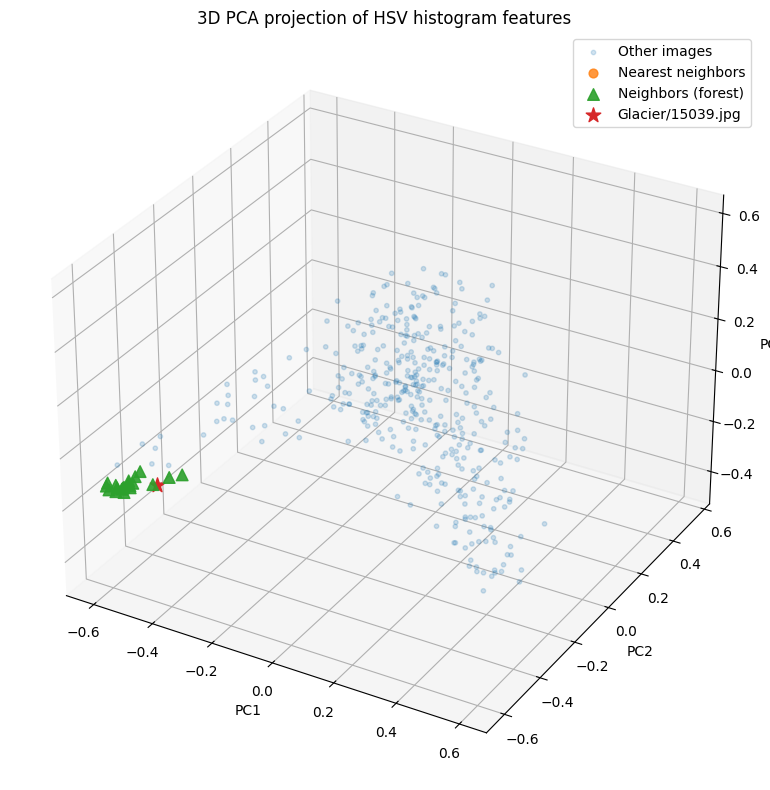

In [234]:
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D  

# Build a subset: target + its neighbors + some random "normal" samples
N_total = train_features.shape[0]
all_indices = np.arange(N_total)

# Choose some random non-neighbor, non-target indices as "background"
exclude = np.concatenate([[target_idx], neighbor_indices])
background_pool = np.setdiff1d(all_indices, exclude)

n_background = 400 
if len(background_pool) < n_background:
    n_background = len(background_pool)

rng = np.random.default_rng(42)
background_indices = rng.choice(background_pool, size=n_background, replace=False)

subset_indices = np.concatenate([[target_idx], neighbor_indices, background_indices])
X_subset = train_features[subset_indices]
y_subset = y_train[subset_indices]

# PCA to 3D
pca = PCA(n_components=3, random_state=42)
X_pca = pca.fit_transform(X_subset)

# Map index in subset -> original index
subset_to_global = subset_indices

# Helper masks
is_target = subset_to_global == target_idx
is_neighbor = np.isin(subset_to_global, neighbor_indices)
is_background = ~(is_target | is_neighbor)

# Mask for neighbors that are 'forest'
forest_label = CLASS_NAMES.index("forest") 
is_neighbor_forest = is_neighbor & (y_subset == forest_label)
is_neighbor_other = is_neighbor & ~is_neighbor_forest

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection="3d")

# background (not directly involved)
ax.scatter(
    X_pca[is_background, 0],
    X_pca[is_background, 1],
    X_pca[is_background, 2],
    s=10,
    alpha=0.2,
    label="Other images",
)

# neighbors from other classes
ax.scatter(
    X_pca[is_neighbor_other, 0],
    X_pca[is_neighbor_other, 1],
    X_pca[is_neighbor_other, 2],
    s=40,
    alpha=0.8,
    label="Nearest neighbors",
)

# neighbors that are 'forest'
ax.scatter(
    X_pca[is_neighbor_forest, 0],
    X_pca[is_neighbor_forest, 1],
    X_pca[is_neighbor_forest, 2],
    s=70,
    marker="^",
    alpha=0.9,
    label="Neighbors (forest)",
)

# target image
ax.scatter(
    X_pca[is_target, 0],
    X_pca[is_target, 1],
    X_pca[is_target, 2],
    s=120,
    marker="*",
    label="Glacier/15039.jpg",
)

ax.set_xlabel("PC1")
ax.set_ylabel("PC2")
ax.set_zlabel("PC3")
ax.set_title("3D PCA projection of HSV histogram features")
ax.legend(loc="best")
plt.tight_layout()
plt.savefig("results/knn_suspicious/HSV_PCA.png", dpi=150)
plt.show()

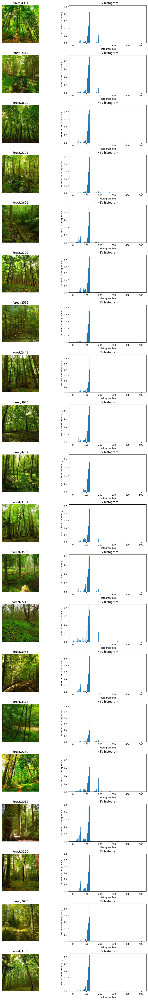

In [235]:
# Get neighbor images (RGB, shape: (K, 128, 128, 3))
neighbor_imgs = X_train[neighbor_indices]

# Compute HSV histograms for ALL neighbors
neighbor_hists = extract_hsv_hist_features(neighbor_imgs)  # shape (K, num_bins)

num_neighbors = len(neighbor_indices)
num_bins = neighbor_hists.shape[1]

# Plot: each row = [image | histogram]
fig, axes = plt.subplots(
    num_neighbors,
    2,
    figsize=(10, 3 * num_neighbors),
    constrained_layout=True,      # <-- handles spacing & centering
)

# Handle the case when num_neighbors == 1 (axes shape is 1D then)
if num_neighbors == 1:
    axes = np.array([axes])

for row, (global_idx, img, hist_vec) in enumerate(
    zip(neighbor_indices, neighbor_imgs, neighbor_hists)
):
    cls = CLASS_NAMES[y_train[global_idx]]

    # Left: original neighbor image
    ax_img = axes[row, 0]
    ax_img.imshow(img)
    ax_img.set_title(f"{cls}/{global_idx}")
    ax_img.axis("off")

    # Right: HSV histogram
    ax_hist = axes[row, 1]
    bins = np.arange(num_bins)
    ax_hist.bar(bins, hist_vec)
    ax_hist.set_title("HSV histogram")
    ax_hist.set_xlabel("Histogram bin")
    ax_hist.set_ylabel("Normalized frequency")

# No tight_layout(); constrained_layout already did it
plt.savefig(
    "results/knn_suspicious/forest_neighbor_histograms.png",
    dpi=150,
    bbox_inches="tight",         
)
plt.show()


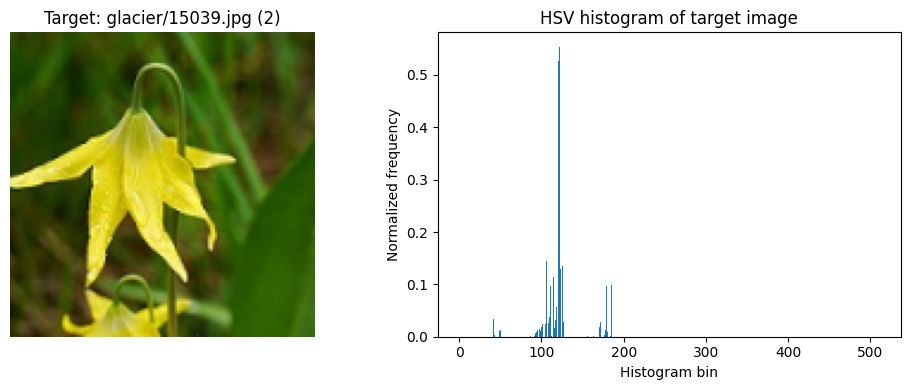

In [236]:
# add one plot showing the target image and hsv histogram. the location is glacier/15039.jpg
target_img = X_train[target_idx]
target_hist = extract_hsv_hist_features(np.array([target_img]))[0]  # shape (num_bins,)
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
# Left: target image
ax_img = axes[0]
ax_img.imshow(target_img)
ax_img.set_title(f"Target: glacier/15039.jpg ({y_train[target_idx]})")
ax_img.axis("off")  
# Right: HSV histogram
ax_hist = axes[1]
bins = np.arange(num_bins)
ax_hist.bar(bins, target_hist)
ax_hist.set_title("HSV histogram of target image")
ax_hist.set_xlabel("Histogram bin")
ax_hist.set_ylabel("Normalized frequency")
plt.tight_layout()
plt.savefig(
    "results/knn_suspicious/glacier_image_histogram.png",
    dpi=150,
    bbox_inches="tight",         
)
plt.show()

## Clean Training Set

In [237]:
def find_exact_duplicates(images, paths):
    """Find exact duplicate images using MD5 hashing on raw bytes."""
    hash_dict = {}
    dup_groups = []
    keep_mask = np.ones(len(images), dtype=bool)

    for i, img in enumerate(images):
        h = hashlib.md5(img.tobytes()).hexdigest()
        if h in hash_dict:
            first_idx = hash_dict[h]
            keep_mask[i] = False

            found_group = False
            for group in dup_groups:
                if paths[first_idx] in group:
                    group.append(paths[i])
                    found_group = True
                    break
            if not found_group:
                dup_groups.append([paths[first_idx], paths[i]])
        else:
            hash_dict[h] = i

    return keep_mask, dup_groups

def find_grayscale_duplicates(images, paths):
    """Find grayscale duplicate images via MD5 hashing on grayscale pixels."""
    hash_dict = {}
    dup_groups = []
    keep_mask = np.ones(len(images), dtype=bool)

    for i, img in enumerate(images):
        gray_img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        h = hashlib.md5(gray_img.tobytes()).hexdigest()
        if h in hash_dict:
            first_idx = hash_dict[h]
            keep_mask[i] = False

            found_group = False
            for group in dup_groups:
                if paths[first_idx] in group:
                    group.append(paths[i])
                    found_group = True
                    break
            if not found_group:
                dup_groups.append([paths[first_idx], paths[i]])
        else:
            hash_dict[h] = i

    return keep_mask, dup_groups

def find_perceptual_duplicates(
    images,
    paths,
    threshold=0,
    hash_func=imagehash.phash,
):
    """
    Find perceptual duplicate images using a perceptual hash.

    threshold:
        Maximum Hamming distance between hashes to consider images duplicates.
        For scene datasets like Intel, keep this at 0 (exact hash matches only)
        to avoid killing natural variation.
    hash_func:
        imagehash function to use (default: phash, better than average_hash here).
    """
    hash_dict = {}
    dup_groups = []
    keep_mask = np.ones(len(images), dtype=bool)

    for i, img in enumerate(images):
        pil_img = Image.fromarray(img)
        h = hash_func(pil_img)

        if threshold == 0:
            # Fast path: only exact hash matches
            if h in hash_dict:
                first_idx = hash_dict[h]
                keep_mask[i] = False

                found_group = False
                for group in dup_groups:
                    if paths[first_idx] in group:
                        group.append(paths[i])
                        found_group = True
                        break
                if not found_group:
                    dup_groups.append([paths[first_idx], paths[i]])
            else:
                hash_dict[h] = i
        else:
            # More permissive path: check Hamming distance to existing hashes
            found_duplicate = False
            for existing_hash in hash_dict:
                if h - existing_hash <= threshold:
                    first_idx = hash_dict[existing_hash]
                    keep_mask[i] = False
                    found_duplicate = True

                    found_group = False
                    for group in dup_groups:
                        if paths[first_idx] in group:
                            group.append(paths[i])
                            found_group = True
                            break
                    if not found_group:
                        dup_groups.append([paths[first_idx], paths[i]])
                    break

            if not found_duplicate:
                hash_dict[h] = i

    return keep_mask, dup_groups

def is_low_edge(img, edge_ratio_thresh=0.01):
    """Checks if an image has a low edge ratio using Canny edge detection."""
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 100, 200)
    edge_pixels = np.sum(edges > 0)
    total_pixels = edges.size
    edge_ratio = edge_pixels / total_pixels
    return edge_ratio < edge_ratio_thresh

def is_almost_constant(img, std_thresh=5.0):
    """Checks if an image is almost constant based on grayscale standard deviation."""
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    stddev = np.std(gray)
    return stddev < std_thresh

def is_too_noisy(img, noise_std_thresh=None):
    """
    Checks if an image is too noisy based on Laplacian stddev.

    For natural scenes (buildings, forest, etc.), this is often *not* useful.
    If noise_std_thresh is None, this check is disabled.
    """
    if noise_std_thresh is None:
        return False

    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    noise_std = np.std(laplacian)
    return noise_std > noise_std_thresh

def is_blurry(img, std_thresh=100.0):
    """Checks if an image is blurry based on the variance of the Laplacian."""
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    variance = laplacian.var()
    return variance < std_thresh

In [238]:
def clean_training_set(
    X,
    y,
    categories,
    paths,
    *,
    perceptual_threshold=0,
    low_edge_ratio_thresh=0.003,  # More conservative for natural scenes
    constant_std_thresh=2.5,      # Slightly stricter for truly blank images
    noise_std_thresh=None,        # disable noisy filter by default
    blur_std_thresh=50.0,         # Stricter blur detection (was 80)
    crop_match_threshold=12,      # Perceptual hash distance for crop matching
):
    """
    Detect potential issues (duplicates, empty/constant/noisy/blurry images)
    in the Intel scene dataset.

    IMPORTANT:
    - This version does NOT remove any images from the dataset.
    - X_clean, y_clean, categories_clean, paths_clean are identical to the inputs.
    - All detected issues are returned via the `info` dict for analysis/plotting.

    Returns:
      X_clean, y_clean, categories_clean, paths_clean, keep_mask, info
    """
    n = len(X)

    # We keep all images; keep_mask is all True and never changed
    keep_mask = np.ones(n, dtype=bool)

    # 1) Exact duplicates (detected for reporting/plotting only)
    exact_mask, exact_dup_groups = find_exact_duplicates(X, paths)

    # 2) Grayscale duplicates (detected for reporting/plotting only)
    gray_mask, gray_dup_groups = find_grayscale_duplicates(X, paths)

    # 3) Perceptual duplicates (detected for reporting/plotting only)
    phash_mask, phash_dup_groups = find_perceptual_duplicates(
        X,
        paths,
        threshold=perceptual_threshold,
    )

    removed_empty = []
    removed_constant = []
    removed_noisy = []
    removed_blurry = []

    # 4–7) Detect other problematic images (but do NOT remove them)
    for i in range(n):
        img = X[i]

        # Empty / almost-empty
        if is_low_edge(img, edge_ratio_thresh=low_edge_ratio_thresh):
            removed_empty.append(paths[i])
            continue

        # Almost constant (e.g. plain black/white)
        if is_almost_constant(img, std_thresh=constant_std_thresh):
            removed_constant.append(paths[i])
            continue

        # Too noisy / unrecognizable (disabled if noise_std_thresh is None)
        if is_too_noisy(img, noise_std_thresh=noise_std_thresh):
            removed_noisy.append(paths[i])
            continue

        # Very blurry (low Laplacian variance)
        if is_blurry(img, std_thresh=blur_std_thresh):
            removed_blurry.append(paths[i])
            continue

    # Build "cleaned" arrays – identical to original, since we keep everything
    X_clean = X
    y_clean = y
    categories_clean = categories
    paths_clean = paths

    # Collect info for analysis/plotting
    info = {
        "exact_duplicate_groups": exact_dup_groups,
        "grayscale_duplicate_groups": gray_dup_groups,
        "perceptual_duplicate_groups": phash_dup_groups,
        "removed_empty": removed_empty,
        "removed_constant": removed_constant,
        "removed_noisy": removed_noisy,
        "removed_blurry": removed_blurry,
    }

    return X_clean, y_clean, categories_clean, paths_clean, keep_mask, info

In [239]:
def show_removed_images(paths_list, title, X, paths, n_cols=3, save_name=None):
    if len(paths_list) == 0:
        return

    # Only show up to n_cols examples
    indices = [np.where(paths == p)[0][0] for p in paths_list[:n_cols] if p in paths]
    if len(indices) == 0:
        return

    fig, axes = plt.subplots(1, len(indices), figsize=(3 * len(indices), 3))
    if len(indices) == 1:
        axes = [axes]

    for i, idx in enumerate(indices):
        axes[i].imshow(X[idx])
        axes[i].set_title(f'{paths[idx]}', fontsize=8)
        axes[i].axis('off')

    plt.suptitle(title)
    plt.tight_layout()

    if save_name:
        save_path = Path(save_name)
        folder = Path(outdir) / save_path.stem
        folder.mkdir(parents=True, exist_ok=True)

        outpath = folder / save_path.name
        plt.savefig(outpath)

    # plt.show()
    plt.close(fig)

In [240]:
def show_duplicate_groups(
    dup_groups,
    X,
    paths,
    title,
    save_name=None,
    y=None,
    class_names=None,   # kept but no longer needed for the new behavior
):
    """
    Plot duplicate pairs.

    If `y` is None:
        - Behaves like the original function: plots *all* pairs in a single figure.

    If `y` is provided:
        - Creates TWO figures:
            1) pairs where both images have the same label ("same category")
            2) pairs where images have different labels ("other category")

      Each figure is saved to:
        outdir / <save_prefix>_<type>_pairs.png
    """
    if not dup_groups:
        return

    paths = np.asarray(paths)

    # Build list of (idx1, idx2) pairs from the groups (same as before)
    pairs = []
    for group in dup_groups:
        group_paths = [p for p in group if p in paths]
        if len(group_paths) < 2:
            continue

        # Pair consecutive items: (p0,p1), (p2,p3), ...
        for i in range(0, len(group_paths) - 1, 2):
            p1 = group_paths[i]
            p2 = group_paths[i + 1]
            idx1 = np.where(paths == p1)[0][0]
            idx2 = np.where(paths == p2)[0][0]
            pairs.append((idx1, idx2))

        # If odd number of images in group, last one is ignored (no partner).

    if not pairs:
        return

    # --- helper to actually plot a grid of pairs (same layout as original) ---
    def _plot_pair_grid(pairs_to_plot, fig_title, save_prefix):
        if not pairs_to_plot:
            return

        n_pairs = len(pairs_to_plot)
        pairs_per_row = 3          # 3 pairs per row
        n_cols = 6                 # 6 images per row (3 pairs)
        n_rows = int(np.ceil(n_pairs / pairs_per_row))

        fig, axes = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols, 3 * n_rows))
        axes = np.array(axes).reshape(n_rows, n_cols)

        # Hide all axes to start
        for ax in axes.ravel():
            ax.axis('off')

        for pair_idx, (idx1, idx2) in enumerate(pairs_to_plot):
            row = pair_idx // pairs_per_row
            col_start = (pair_idx % pairs_per_row) * 2  # (0, 2, 4)

            ax1 = axes[row, col_start]
            ax2 = axes[row, col_start + 1]

            ax1.imshow(X[idx1])
            ax1.set_title(f'{paths[idx1]}', fontsize=8)
            ax1.axis('off')

            ax2.imshow(X[idx2])
            ax2.set_title(f'{paths[idx2]}', fontsize=8)
            ax2.axis('off')

        # Add suptitle and leave some space above the grid
        fig.suptitle(fig_title, y=0.99)
        # Shrink the axes area so it doesn't collide with the suptitle
        fig.tight_layout(rect=[0, 0, 1, 0.97])

        if save_prefix:
            folder = Path(outdir) / save_prefix
            folder.mkdir(parents=True, exist_ok=True)
            outpath = folder / f'{save_prefix}_pairs.png'
            plt.savefig(outpath)

        # plt.show()
        plt.close(fig)

    # --- CASE 1: no labels given -> old behavior: one big figure with all pairs ---
    if y is None:
        _plot_pair_grid(pairs, title, save_name)
        return

    # --- CASE 2: labels given -> split into same-label vs different-label globally ---
    y = np.asarray(y)

    pair_infos = []
    for idx1, idx2 in pairs:
        c1 = int(y[idx1])
        c2 = int(y[idx2])
        pair_infos.append((idx1, idx2, c1, c2))

    same_pairs = [(i1, i2) for (i1, i2, c1, c2) in pair_infos if c1 == c2]
    diff_pairs = [(i1, i2) for (i1, i2, c1, c2) in pair_infos if c1 != c2]

    base_prefix = save_name if save_name is not None else "duplicates"

    if same_pairs:
        fig_title = f"{title} with same category"
        prefix = f"{base_prefix}_same_label"
        _plot_pair_grid(same_pairs, fig_title, prefix)

    if diff_pairs:
        fig_title = f"{title} with different categories"
        prefix = f"{base_prefix}_diff_label"
        _plot_pair_grid(diff_pairs, fig_title, prefix)


In [241]:
print("Train shape before cleaning:", X_train.shape)

(
  X_train_clean, 
  y_train_clean, 
  train_categories_clean,
  train_paths_clean, 
  train_keep_mask, 
  clean_info 
) = clean_training_set(X_train, y_train, train_categories, train_paths)

print("Train shape after cleaning:", X_train_clean.shape)

info_table = pd.DataFrame({
    'Type': [
        'Exact Duplicates',
        'Grayscale Duplicates',
        'Perceptual Duplicates',
        'Empty/Low Edge',
        'Almost Constant',
        'Too Noisy',
        'Blurry',
    ],
    'Count': [
        sum(len(g) for g in clean_info['exact_duplicate_groups']),
        sum(len(g) for g in clean_info['grayscale_duplicate_groups']),
        sum(len(g) for g in clean_info['perceptual_duplicate_groups']),
        len(clean_info['removed_empty']),
        len(clean_info['removed_constant']),
        len(clean_info['removed_noisy']),
        len(clean_info['removed_blurry']),
    ]
})
display(info_table)


Train shape before cleaning: (14034, 128, 128, 3)
Train shape after cleaning: (14034, 128, 128, 3)
Train shape after cleaning: (14034, 128, 128, 3)


,Type,Count
0,Exact Duplicates,30
1,Grayscale Duplicates,30
2,Perceptual Duplicates,80
3,Empty/Low Edge,8
4,Almost Constant,0
5,Too Noisy,0
6,Blurry,6


In [242]:
# All duplicate pairs (for each type) in single figures, with 4 images (2 pairs) per row
show_duplicate_groups(
    clean_info['exact_duplicate_groups'],
    X_train,
    train_paths,
    'Exact Duplicates',
    save_name='exact_duplicates',
    y=y_train,
)

show_duplicate_groups(
    clean_info['perceptual_duplicate_groups'],
    X_train,
    train_paths,
    'Perceptual Duplicates',
    save_name='perceptual_duplicates',
    y=y_train,
)


# Example images for each "problem" category (still just illustrative, no removals)
show_removed_images(
    clean_info['removed_empty'],
    'Empty/Low Edge Images',
    X_train,
    train_paths,
    n_cols=6,
    save_name='empty_low_edge_examples.png'
)

show_removed_images(
    clean_info['removed_constant'],
    'Almost Constant Images',
    X_train,
    train_paths,
    n_cols=6,
    save_name='almost_constant_examples.png'
)

show_removed_images(
    clean_info['removed_noisy'],
    'Too Noisy Images',
    X_train,
    train_paths,
    n_cols=6,
    save_name='too_noisy_examples.png'
)

show_removed_images(
    clean_info['removed_blurry'],
    'Blurry Images',
    X_train,
    train_paths,
    n_cols=6,
    save_name='blurry_examples.png'
)

## Resize Images

In [243]:
CLASS_NAMES = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

def show_before_after_examples(root_folder, n_per_class=3, target_size=(128, 128)):
    """
    For each class in CLASS_NAMES, display n_per_class pairs:
    [original | resized] per image, in one row per class.
    """
    num_classes = len(CLASS_NAMES)
    cols = n_per_class * 2  # original + resized for each image

    fig, axes = plt.subplots(num_classes, cols, figsize=(4 * cols, 3 * num_classes))

    # Title must be added with suptitle BEFORE layout adjustment
    fig.suptitle("Images Before and After Resizing", fontsize=18, y=1.02)

    if num_classes == 1:
        axes = np.expand_dims(axes, axis=0)

    for row, class_name in enumerate(CLASS_NAMES):
        class_folder = os.path.join(root_folder, class_name)
        if not os.path.isdir(class_folder):
            print(f"Warning: folder not found for class '{class_name}': {class_folder}")
            continue

        filenames = [f for f in os.listdir(class_folder) if not f.startswith('.')]
        filenames = filenames[:n_per_class]

        for i, filename in enumerate(filenames):
            img_path = os.path.join(class_folder, filename)
            img_bgr = cv2.imread(img_path)
            if img_bgr is None:
                continue

            img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
            resized_rgb = cv2.resize(img_rgb, target_size)

            col_orig = 2 * i
            col_resized = 2 * i + 1

            ax_orig = axes[row, col_orig]
            ax_orig.imshow(img_rgb)
            if i == 0:
                ax_orig.set_ylabel(class_name.capitalize(), fontsize=12)
            ax_orig.set_title("Original")
            ax_orig.axis("off")

            ax_res = axes[row, col_resized]
            ax_res.imshow(resized_rgb)
            ax_res.set_title(f"Resized {target_size[0]}×{target_size[1]}")
            ax_res.axis("off")

        # Hide unused axes
        for empty_col in range(2 * len(filenames), cols):
            axes[row, empty_col].axis("off")

    # Adjust layout so the title stays visible
    plt.tight_layout(rect=[0, 0, 1, 0.97])

    plt.savefig("results/before_after_resizing.png", dpi=150, bbox_inches="tight")
    plt.show()


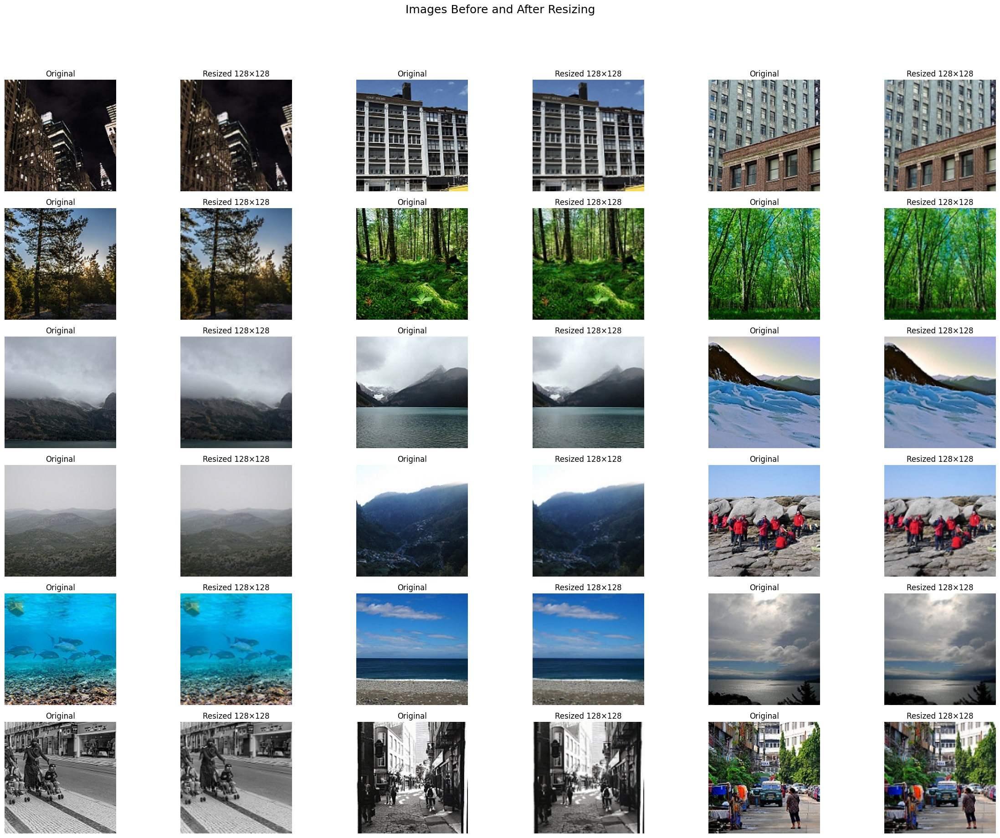

TypeError: cannot unpack non-iterable NoneType object

In [244]:
train_root = "intel-image-classification/seg_train/seg_train/"
widths, heights = show_before_after_examples(train_root, n_per_class=3, target_size=(128, 128))

## Normalize Images

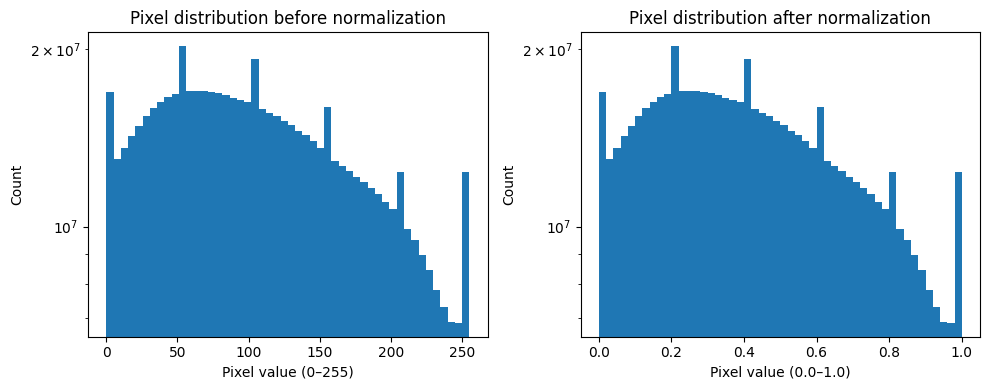

In [245]:
from matplotlib.ticker import LogFormatterMathtext

def normalize_images(X):
    """
    Normalize images from uint8 [0, 255] to float32 [0.0, 1.0].
    """
    return X.astype(np.float32) / 255.0


def plot_pixel_distributions_before_after(X_before, X_after, save_path=None):
    """
    Plot pixel intensity distributions before and after normalization
    with log-scaled y-axis labeled as powers of 10 (10^2, 10^3, ...).
    """
    # Flatten all channels
    pixels_before = X_before.reshape(-1, 3)
    pixels_after = X_after.reshape(-1, 3)

    fig, axes = plt.subplots(1, 2, figsize=(10, 4))

    # ---- Before normalization: 0–255 ----
    ax1 = axes[0]
    ax1.hist(pixels_before.ravel(), bins=50, range=(0, 255))
    ax1.set_title("Pixel distribution before normalization")
    ax1.set_xlabel("Pixel value (0–255)")
    ax1.set_ylabel("Count")

    # log scale + nice 10^k labels
    ax1.set_yscale("log")
    ax1.yaxis.set_major_formatter(LogFormatterMathtext())

    # ---- After normalization: 0–1 ----
    ax2 = axes[1]
    ax2.hist(pixels_after.ravel(), bins=50, range=(0.0, 1.0))
    ax2.set_title("Pixel distribution after normalization")
    ax2.set_xlabel("Pixel value (0.0–1.0)")
    ax2.set_ylabel("Count")

    ax2.set_yscale("log")
    ax2.yaxis.set_major_formatter(LogFormatterMathtext())

    plt.tight_layout()
    if save_path is not None:
        plt.savefig(save_path, dpi=150, bbox_inches="tight")
    plt.show()


# Example usage
X_train_norm = normalize_images(X_train)
plot_pixel_distributions_before_after(
    X_train,
    X_train_norm,
    save_path="results/pixel_normalization_hist.png"
)

## Data Augmentation

In [253]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

CLASS_NAMES = ['buildings', 'forest', 'glacier', 'mountain', 'sea', 'street']

def horizontal_flip(img):
    return cv2.flip(img, 1)

def affine_skew(img, shear_factor=0.2):
    """
    Simple horizontal shear (skew) using an affine transform.
    shear_factor > 0 skews to the right.
    """
    h, w = img.shape[:2]
    M = np.float32([[1, shear_factor, 0],
                    [0, 1,           0]])
    skewed = cv2.warpAffine(
        img,
        M,
        (w, h),
        borderMode=cv2.BORDER_REFLECT_101
    )
    return skewed

def central_crop_resize(img, crop_frac=0.8, target_size=(128, 128)):
    """
    Central crop by crop_frac (e.g. 0.8 keeps 80% in the center),
    then resize back to target_size.
    """
    h, w = img.shape[:2]
    new_h = int(h * crop_frac)
    new_w = int(w * crop_frac)

    start_y = (h - new_h) // 2
    start_x = (w - new_w) // 2
    end_y = start_y + new_h
    end_x = start_x + new_w

    cropped = img[start_y:end_y, start_x:end_x]
    resized = cv2.resize(cropped, target_size)
    return resized

def show_augmentation_examples(root_folder, target_size=(128, 128)):
    """
    For each class in CLASS_NAMES, pick one image and show:
    [Original | Horizontal flip | Affine skew | Central crop]
    -> 4 images per row, one row per class.

    Only visualizes augmentations; does NOT modify X_train.
    """
    num_classes = len(CLASS_NAMES)
    cols = 4  # original + 3 augmentations

    fig, axes = plt.subplots(num_classes, cols, figsize=(4 * cols, 3 * num_classes))
    fig.suptitle("Data augmentation examples per category", fontsize=18, y=1.02)

    # Ensure axes is 2D
    if num_classes == 1:
        axes = np.expand_dims(axes, axis=0)

    for row, class_name in enumerate(CLASS_NAMES):
        class_folder = os.path.join(root_folder, class_name)
        if not os.path.isdir(class_folder):
            print(f"Warning: folder not found for class '{class_name}': {class_folder}")
            for c in range(cols):
                axes[row, c].axis("off")
            continue

        # Pick one image from this class
        filenames = [f for f in os.listdir(class_folder) if not f.startswith('.')]
        if len(filenames) == 0:
            print(f"Warning: no images found for class '{class_name}' in {class_folder}")
            for c in range(cols):
                axes[row, c].axis("off")
            continue

        filename = filenames[0]
        img_path = os.path.join(class_folder, filename)
        img_bgr = cv2.imread(img_path)
        if img_bgr is None:
            print(f"Warning: could not read image {img_path}")
            for c in range(cols):
                axes[row, c].axis("off")
            continue

        img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

        # Augmentations
        flip_img = horizontal_flip(img_rgb)
        skew_img = affine_skew(img_rgb, shear_factor=0.2)
        crop_resized_img = central_crop_resize(img_rgb, crop_frac=0.8, target_size=target_size)

        images = [
            ("Original", img_rgb),
            ("Horizontal flip", flip_img),
            ("Affine skew", skew_img),
            ("Central crop", crop_resized_img),
        ]

        for col, (title, img_to_show) in enumerate(images):
            ax = axes[row, col]
            ax.imshow(img_to_show)
            if col == 0:
                ax.set_ylabel(class_name.capitalize(), fontsize=12)
            ax.set_title(title, fontsize=10)
            ax.axis("off")

    plt.tight_layout(rect=[0, 0, 1, 0.97])
    plt.savefig("results/data_augmentation_examples.png", dpi=150, bbox_inches="tight")
    plt.show()


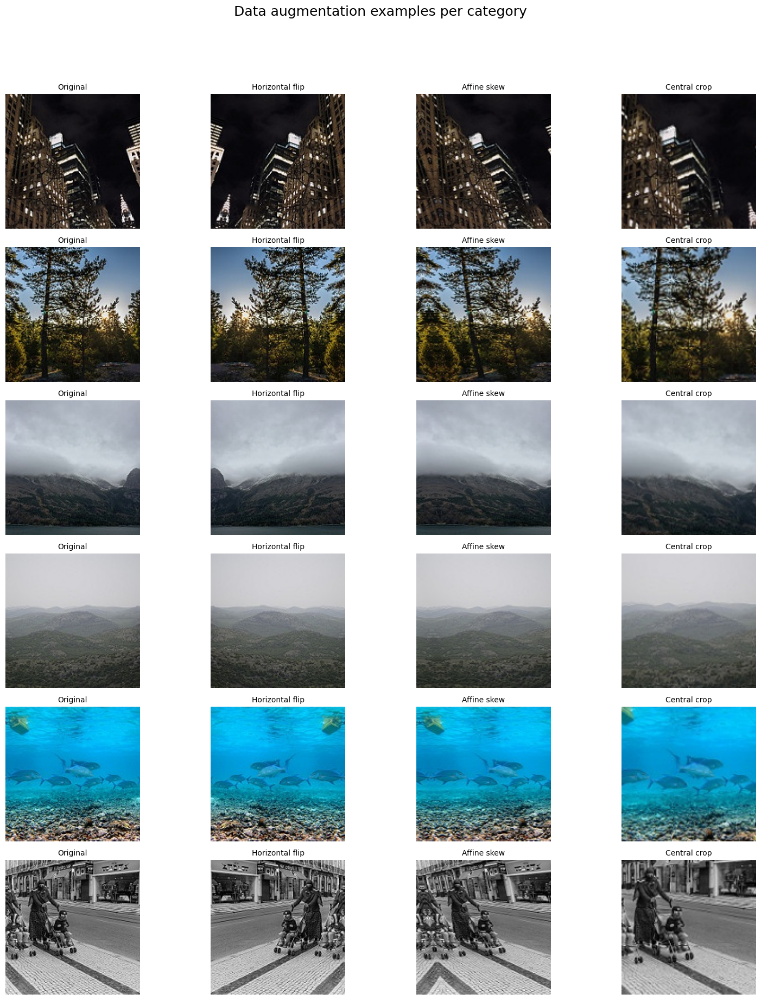

In [254]:
root_folder = "intel-image-classification/seg_train/seg_train/"
show_augmentation_examples(root_folder, target_size=(128, 128))

## Extract features from images

In [50]:
import cv2
import numpy as np
from skimage.feature import hog, local_binary_pattern
from tqdm import tqdm

def extract_features(batch):
    feats = []
    for img in tqdm(batch, desc="Extracting features"):
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        
        edges = cv2.Canny(gray, 128, 128).flatten().astype(np.float32) / 255.0

        fd, _ = hog(
            gray,
            orientations=16,
            pixels_per_cell=(8, 8),
            cells_per_block=(2, 2),
            visualize=True,
            channel_axis=None,
        )

        lbp = local_binary_pattern(gray, P=10, R=3, method="uniform")
        lbp_hist, _ = np.histogram(lbp.ravel(), bins=np.arange(0, lbp.max() + 2), density=True)
        
        # feats.append(np.concatenate([fd, lbp_hist, edges]))
        feats.append(np.concatenate([fd, lbp_hist]))
    return np.asarray(feats, dtype=np.float32)

# X_train_feats = extract_features(X_train)
# X_test_feats = extract_features(X_test)
# y_train_feats = y_train.copy()
# y_test_feats = y_test.copy()